# DINOv3 Attention Analysis

## Overview
Comprehensive toolkit for exploring Vision Transformer attention patterns.

## Token Structure
```
DINOv3 ViT-S/16 with 224×224 input:
┌─────────────┬──────────────────┬────────────────────┐
│ CLS Token   │ Register Tokens  │ Patch Tokens       │
│ [0]         │ [1, 2, 3, 4]     │ [5...200]          │
│ 1 token     │ 4 tokens         │ 196 tokens (14×14) │
└─────────────┴──────────────────┴────────────────────┘
Total: 201 tokens
```

In [1]:
# Import libraries
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from pathlib import Path
from tqdm.auto import tqdm
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

# Deep learning libraries
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image
import cv2

# Setup paths
current_dir = os.getcwd()
project_root = os.path.dirname(current_dir)
sys.path.insert(0, project_root)
dinov3_path = os.path.join(project_root, "dinov3")
sys.path.insert(0, dinov3_path)

# Import custom modules
from data.csv_dataset import CSVDataset
from src.models.dinov3_lightning_model import DINOv3LightningModule

# Device configuration
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Professional plotting style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")
plt.rcParams.update({
    'figure.facecolor': 'white',
    'axes.facecolor': '#f8f9fa',
    'axes.edgecolor': '#dee2e6',
    'axes.linewidth': 1.2,
    'grid.color': 'white',
    'grid.linewidth': 1.5,
    'font.size': 10,
    'axes.labelsize': 11,
    'axes.titlesize': 12,
    'legend.fontsize': 9,
    'figure.titlesize': 14,
    'font.family': 'sans-serif',
})

print(f"Device: {DEVICE}")
print(f"PyTorch: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

/home/marjans/anaconda3/envs/dlv2/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Device: cuda
PyTorch: 2.8.0+cu128
CUDA available: True


## Configuration

In [2]:
# Configuration
class Config:
    """Configuration for attention analysis"""
    
    # Dataset
    CSV_PATH = '../patches.csv'
    CSV_IMAGE_COL = 'image_path'
    CSV_SEPARATOR = ','
    CSV_BASE_PATH = None
    
    # Model Selection
    USE_ORIGINAL_MODEL = True
    USE_FINETUNED_MODEL = True
    
    # Sampling
    NUM_EXAMPLES = 25
    USE_RANDOM_SEED = False
    RANDOM_SEED = 42
    
    # Attention
    LAYERS_TO_VISUALIZE = [2, 8, 11]
    ATTENTION_SOURCE = 'cls'  # 'cls', 'mean', 'patch_center', 'patch_random', 'patch_X'
    ATTENTION_AGGREGATION = 'mean'  # 'mean', 'max', 'min', 'head_X'
    
    # Visualization
    COLORMAP = 'turbo'  # Single colormap
    SHOW_SEGMENTATION = True  # Show attention-based segmentation with contours
    SEGMENTATION_THRESHOLD = 0.5  # Threshold for segmentation
    
    # Output
    SAVE_HIGH_RES = True
    DPI = 200

# Get project root
current_dir = os.getcwd()
project_root = os.path.dirname(current_dir)

# Model paths
MODEL_PATHS = {
    'original': os.path.join(project_root, 'dinov3_official_weights', 'dinov3_vits16_pretrain_lvd1689m-08c60483.pth'),
    'finetuned': os.path.join(project_root, 'output', 'checkpoints', 'last.ckpt'),
    'config': os.path.join(project_root, 'configs', 'config_lightning_finetuning_v2.yaml')
}

# Output directory
timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
OUTPUT_DIR = Path(f'./attention_analysis_{timestamp}')
OUTPUT_DIR.mkdir(exist_ok=True)

# Set random seeds
if Config.USE_RANDOM_SEED:
    seed = Config.RANDOM_SEED
else:
    seed = int(datetime.now().timestamp() * 1000) % (2**32)

torch.manual_seed(seed)
np.random.seed(seed)

print(f"Dataset: {Config.CSV_PATH}")
print(f"Samples: {Config.NUM_EXAMPLES}")
print(f"Models: Original={Config.USE_ORIGINAL_MODEL}, Finetuned={Config.USE_FINETUNED_MODEL}")
print(f"Layers: {Config.LAYERS_TO_VISUALIZE}")
print(f"Attention source: {Config.ATTENTION_SOURCE}")
print(f"Colormap: {Config.COLORMAP}")
print(f"Segmentation: {Config.SHOW_SEGMENTATION}")
print(f"Output: {OUTPUT_DIR}")

Dataset: ../patches.csv
Samples: 25
Models: Original=True, Finetuned=True
Layers: [2, 8, 11]
Attention source: cls
Colormap: turbo
Segmentation: True
Output: attention_analysis_20251210_140426


## Dataset Loading

In [3]:
def extract_label_from_filename(filepath):
    """Extract label from filename"""
    filename = Path(filepath).stem
    
    if '_state_' in filename:
        before_state = filename.split('_state_')[0]
        if before_state.startswith('coord_'):
            parts = before_state.split('_')
            if len(parts) > 3:
                label = '_'.join(parts[3:])
            else:
                label = before_state
        else:
            label = before_state
    else:
        label = filename
    
    return label

# Load CSV
print("Loading dataset...")
df = pd.read_csv(Config.CSV_PATH)
print(f"Loaded {len(df):,} samples")

# Extract labels
df['label'] = [extract_label_from_filename(p) for p in df[Config.CSV_IMAGE_COL]]
unique_labels = sorted(set(df['label']))
print(f"Found {len(unique_labels)} unique labels")

# Select examples
example_indices = np.random.choice(len(df), min(Config.NUM_EXAMPLES, len(df)), replace=False)
example_df = df.iloc[example_indices].reset_index(drop=True)

print(f"Selected {len(example_df)} examples:")
for idx, row in example_df.iterrows():
    print(f"  [{idx+1}] {row['label']}: {Path(row[Config.CSV_IMAGE_COL]).name}")

Loading dataset...
Loaded 81,536 samples
Found 14 unique labels
Selected 25 examples:
  [1] Th_CD4+_PD1: coord_8512_13664_Th_CD4+_PD1_state_None_lvl_4.tiff
  [2] EndothelialCells: coord_12992_9184_EndothelialCells_state_None_lvl_2.tiff
  [3] Th_CD4+_PD1: coord_1792_10080_Th_CD4+_PD1_state_None_lvl_4.tiff
  [4] FAP+Fibroblasts: coord_8064_8064_FAP+Fibroblasts_state_None_lvl_3.tiff
  [5] CTL_CD8+PD1: coord_5600_5152_CTL_CD8+PD1_state_None_lvl_4.tiff
  [6] Th_CD4+_PD1: coord_3808_3136_Th_CD4+_PD1_state_None_lvl_4.tiff
  [7] CTL_CD8+PD1: coord_12320_8064_CTL_CD8+PD1_state_None_lvl_4.tiff
  [8] CTL_CD8+PD1: coord_7392_4704_CTL_CD8+PD1_state_None_lvl_4.tiff
  [9] Th_CD4+: coord_6720_7392_Th_CD4+_state_None_lvl_4.tiff
  [10] FibroblastCells: coord_8064_3360_FibroblastCells_state_None_lvl_2.tiff
  [11] MyeloidCells: coord_5600_9408_MyeloidCells_state_None_lvl_3.tiff
  [12] CTL_CD8+KI67+: coord_3136_0_CTL_CD8+KI67+_state_None_lvl_5.tiff
  [13] CTL_CD8+: coord_8288_5152_CTL_CD8+_state_None_lvl_4

## Attention Extractor

In [4]:
class AttentionExtractor:
    """Attention extraction with full flexibility"""
    
    def __init__(self, model, model_name):
        self.model = model
        self.model_name = model_name
        
        # Detect register tokens
        if hasattr(model, 'n_storage_tokens'):
            self.n_storage_tokens = model.n_storage_tokens
        elif hasattr(model, 'num_register_tokens'):
            self.n_storage_tokens = model.num_register_tokens
        else:
            self.n_storage_tokens = 0
        
        # Detect number of heads
        if hasattr(model, 'blocks') and len(model.blocks) > 0:
            self.num_heads = model.blocks[0].attn.num_heads
        else:
            self.num_heads = 6  # Default for ViT-S
        
        print(f"  Model '{model_name}': {self.n_storage_tokens} register tokens, {self.num_heads} heads")
    
    def get_full_attention_maps(self, image, layers):
        """Extract full attention maps"""
        self.model.eval()
        attention_data = {}
        
        with torch.no_grad():
            x = image.to(DEVICE)
            
            # Prepare tokens
            if hasattr(self.model, 'prepare_tokens_with_masks'):
                result = self.model.prepare_tokens_with_masks(x)
                x = result[0] if isinstance(result, tuple) else result
            elif hasattr(self.model, 'prepare_tokens'):
                result = self.model.prepare_tokens(x)
                x = result[0] if isinstance(result, tuple) else result
            else:
                if hasattr(self.model, 'patch_embed'):
                    x = self.model.patch_embed(x)
                    if hasattr(self.model, 'pos_embed') and self.model.pos_embed is not None:
                        x = x + self.model.pos_embed
                    if hasattr(self.model, 'cls_token'):
                        cls_tokens = self.model.cls_token.expand(x.shape[0], -1, -1)
                        x = torch.cat((cls_tokens, x), dim=1)
            
            # Token indices
            patch_start_idx = 1 + self.n_storage_tokens
            num_patch_tokens = x.shape[1] - patch_start_idx
            
            # Extract attention for each layer
            if hasattr(self.model, 'blocks'):
                for layer_idx, block in enumerate(self.model.blocks):
                    if layer_idx in layers:
                        attn_module = block.attn
                        B, N, C = x.shape
                        
                        # Apply layer norm
                        x_norm = block.norm1(x)
                        
                        # Get QKV
                        qkv = attn_module.qkv(x_norm)
                        qkv = qkv.reshape(B, N, 3, attn_module.num_heads, C // attn_module.num_heads)
                        qkv = qkv.permute(2, 0, 3, 1, 4)
                        q, k, v = qkv[0], qkv[1], qkv[2]
                        
                        # Compute full attention matrix
                        attn_full = (q @ k.transpose(-2, -1)) * attn_module.scale
                        attn_full = attn_full.softmax(dim=-1)  # (B, H, N, N)
                        
                        # Extract different views
                        attention_data[layer_idx] = {
                            'full': attn_full.detach().cpu(),
                            'cls_to_patches': attn_full[:, :, 0, patch_start_idx:].detach().cpu(),
                            'patches_to_patches': attn_full[:, :, patch_start_idx:, patch_start_idx:].detach().cpu(),
                            'mean_to_patches': attn_full[:, :, :, patch_start_idx:].mean(dim=2).detach().cpu(),
                            'patch_start_idx': patch_start_idx,
                            'num_patch_tokens': num_patch_tokens,
                        }
                    
                    # Forward through block
                    x = block(x)
        
        return attention_data

print("Attention extractor defined")

Attention extractor defined


In [5]:
def load_models():
    """Load models"""
    models = {}
    extractors = {}
    
    print("Loading models...")
    
    if Config.USE_ORIGINAL_MODEL:
        print("Loading original DINOv3...")
        try:
            dinov3_hub_path = os.path.join(project_root, 'dinov3')
            model = torch.hub.load(
                dinov3_hub_path, 'dinov3_vits16',
                source='local', weights=MODEL_PATHS['original'], pretrained=True
            )
            model.to(DEVICE)
            model.eval()
            models['original'] = model
            extractors['original'] = AttentionExtractor(model, 'original')
        except Exception as e:
            print(f"Failed: {e}")
    
    if Config.USE_FINETUNED_MODEL:
        print("Loading fine-tuned DINOv3...")
        try:
            lightning_model = DINOv3LightningModule.load_from_checkpoint(
                MODEL_PATHS['finetuned'],
                cfg_path=MODEL_PATHS['config'],
                map_location=DEVICE,
                strict=True
            )
            model = lightning_model.ssl_model.teacher.backbone
            model.eval()
            models['finetuned'] = model
            extractors['finetuned'] = AttentionExtractor(model, 'finetuned')
        except Exception as e:
            print(f"Failed: {e}")
    
    print(f"Successfully loaded {len(models)} model(s)")
    
    return models, extractors

models, extractors = load_models()

INFO:dinov3:using base=100 for rope new
INFO:dinov3:using min_period=None for rope new
INFO:dinov3:using max_period=None for rope new
INFO:dinov3:using normalize_coords=separate for rope new
INFO:dinov3:using shift_coords=None for rope new
INFO:dinov3:using rescale_coords=2 for rope new
INFO:dinov3:using jitter_coords=None for rope new
INFO:dinov3:using dtype=fp32 for rope new
INFO:dinov3:using mlp layer as FFN


Loading models...
Loading original DINOv3...
  Model 'original': 4 register tokens, 6 heads
Loading fine-tuned DINOv3...


INFO:dinov3_lightning:Building DINOv3 SSL model...
INFO:dinov3:using base=100.0 for rope new
INFO:dinov3:using min_period=None for rope new
INFO:dinov3:using max_period=None for rope new
INFO:dinov3:using normalize_coords=separate for rope new
INFO:dinov3:using shift_coords=None for rope new
INFO:dinov3:using rescale_coords=None for rope new
INFO:dinov3:using jitter_coords=None for rope new
INFO:dinov3:using dtype=bf16 for rope new
INFO:dinov3:using mlp layer as FFN
INFO:dinov3:fp8 matmuls: OFF (disabled in config)
INFO:dinov3:using base=100.0 for rope new
INFO:dinov3:using min_period=None for rope new
INFO:dinov3:using max_period=None for rope new
INFO:dinov3:using normalize_coords=separate for rope new
INFO:dinov3:using shift_coords=None for rope new
INFO:dinov3:using rescale_coords=None for rope new
INFO:dinov3:using jitter_coords=None for rope new
INFO:dinov3:using dtype=bf16 for rope new
INFO:dinov3:using mlp layer as FFN
INFO:dinov3:fp8 matmuls: OFF (disabled in config)
INFO:dino

  Model 'finetuned': 4 register tokens, 6 heads
Successfully loaded 2 model(s)


## Visualization Functions

In [6]:
def load_and_preprocess_image(img_path, base_path=None):
    """Load and preprocess image"""
    # Resolve path
    if base_path and not os.path.isabs(img_path):
        img_path = os.path.join(base_path, img_path)
    img_path = os.path.normpath(img_path)
    
    # Load image
    image = Image.open(img_path).convert('RGB')
    
    # DINOv3 preprocessing
    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    display_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
    ])
    
    image_tensor = transform(image).unsqueeze(0)
    image_display = np.array(display_transform(image))
    
    return image_tensor, image_display


def denormalize_image(image_tensor):
    """Denormalize image for visualization"""
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    
    # Denormalize
    image = image_tensor.squeeze(0).permute(1, 2, 0).cpu().numpy()
    image = image * std + mean
    image = np.clip(image * 255, 0, 255).astype(np.uint8)
    
    return image


def apply_attention_overlay(image, attention_map, colormap='viridis', threshold=None, alpha=0.5):
    """
    Apply attention as overlay on the RGB image.

    Args:
        image: H x W x 3 RGB numpy array (uint8)
        attention_map: 1D array of length num_patches (e.g. 196 for 14x14)
        colormap: matplotlib colormap name
        threshold: if not None, values below threshold are set to 0 for visualization
        alpha: blending factor for cv2.addWeighted
    """
    H, W = image.shape[:2]

    # Patch grid (ViT-S/16, 224x224 -> 14x14)
    patch_size = 16
    num_patches_h = H // patch_size
    num_patches_w = W // patch_size
    expected_tokens = num_patches_h * num_patches_w

    attention_map = np.asarray(attention_map)
    if attention_map.size != expected_tokens:
        raise ValueError(f"Expected {expected_tokens} tokens, got {attention_map.size}")

    # Reshape to 2D grid and upsample to image size
    attn_2d = attention_map.reshape(num_patches_h, num_patches_w)
    attn_resized = cv2.resize(attn_2d, (W, H), interpolation=cv2.INTER_CUBIC)

    # Normalize to [0, 1]
    attn_min, attn_max = attn_resized.min(), attn_resized.max()
    if attn_max > attn_min:
        attn_norm = (attn_resized - attn_min) / (attn_max - attn_min + 1e-6)
    else:
        attn_norm = np.zeros_like(attn_resized, dtype=np.float32)

    # Optionally zero-out low attention for visualization only
    if threshold is not None:
        attn_vis = np.where(attn_norm >= threshold, attn_norm, 0.0)
    else:
        attn_vis = attn_norm

    import matplotlib.cm as cm
    cmap = cm.get_cmap(colormap)
    heatmap = (cmap(attn_vis) * 255).astype(np.uint8)[:, :, :3]

    # Blend
    overlay = cv2.addWeighted(image, 1 - alpha, heatmap, alpha, 0)

    # return overlay + full normalized map (without thresholding)
    return overlay, attn_norm


def create_attention_segmentation(image, attention_map, threshold=0.6):
    """Create segmentation from attention map with contours"""
    H, W = image.shape[:2]
    
    # Calculate patch dimensions
    patch_size = 16
    num_patches_h = H // patch_size
    num_patches_w = W // patch_size
    
    # Reshape to 2D
    attn_2d = attention_map.reshape(num_patches_h, num_patches_w)
    attn_resized = cv2.resize(attn_2d, (W, H), interpolation=cv2.INTER_CUBIC)
    
    # Normalize
    attn_min, attn_max = attn_resized.min(), attn_resized.max()
    if attn_max > attn_min:
        attn_norm = (attn_resized - attn_min) / (attn_max - attn_min)
    else:
        attn_norm = attn_resized
    
    # Create binary mask
    mask = (attn_norm > threshold).astype(np.uint8) * 255
    
    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Create visualization
    result = image.copy()
    
    # Draw filled mask with transparency
    colored_mask = np.zeros_like(image)
    colored_mask[mask > 0] = [0, 255, 0]  # Green color
    result = cv2.addWeighted(result, 0.7, colored_mask, 0.3, 0)
    
    # Draw contours
    cv2.drawContours(result, contours, -1, (0, 255, 0), 2)
    
    return result, mask


def get_attention_for_source(attention_data, source):
    """
    Get attention based on source specification.

    Returns: (B, H, num_patches) attention tensor
    """
    if source == "cls":
        # CLS token → patches
        return attention_data["cls_to_patches"]

    elif source == "mean":
        # Mean attention over all tokens → patches
        return attention_data["mean_to_patches"]

    elif source == "patch_center":
        # Center patch → all patches
        num_patches = attention_data["num_patch_tokens"]
        grid_size = int(np.sqrt(num_patches))  # e.g. 14 for 196 patches
        center_idx = (grid_size // 2) * grid_size + (grid_size // 2)
        return attention_data["patches_to_patches"][:, :, center_idx, :]

    elif source == "patch_random":
        # Random patch → all patches
        num_patches = attention_data["num_patch_tokens"]
        random_idx = np.random.randint(0, num_patches)
        return attention_data["patches_to_patches"][:, :, random_idx, :]

    elif source.startswith("patch_"):
        # Specific patch index, e.g. "patch_37"
        try:
            patch_idx = int(source.split("_")[1])
            return attention_data["patches_to_patches"][:, :, patch_idx, :]
        except Exception:
            print(f"Warning: invalid patch index in '{source}', falling back to CLS→patch")
            return attention_data["cls_to_patches"]

    else:
        print(f"Warning: unknown source '{source}', using CLS→patch")
        return attention_data["cls_to_patches"]


print("Visualization functions defined")

Visualization functions defined


## Main Visualization

In [7]:
def create_comprehensive_visualization(img_path, label, extractors, layers, base_path=None):
    """
    Create comprehensive attention visualization.

    Layout:
    - Rows  : models (original, finetuned)
    - Cols  : for each layer -> [original, overlay, segmentation (optional)]
    """
    print(f"\nAnalyzing: {label}")

    # Load image once
    image_tensor, image_display = load_and_preprocess_image(img_path, base_path)
    print("Image loaded")

    # Enforce model order: original first, then finetuned (if present)
    model_order = ['original', 'finetuned']
    model_order = [m for m in model_order if m in extractors]

    # Fallback if only one / different key(s)
    if not model_order:
        model_order = list(extractors.keys())

    n_models = len(model_order)
    n_layers = len(layers)

    # Decide how many subcolumns per layer (segmentation optional)
    n_subcols = 3 if getattr(Config, "SHOW_SEGMENTATION", False) else 2

    # Figure size and grid
    fig_width = 3.5 * n_layers * n_subcols
    fig_height = 3.5 * n_models
    fig = plt.figure(figsize=(fig_width, fig_height))

    gs = gridspec.GridSpec(
        n_models,
        n_layers * n_subcols,
        hspace=0.3,
        wspace=0.25,
        top=0.78,
        bottom=0.06,
        left=0.04,
        right=0.98,
    )

    # Precompute attention maps for all models
    all_attention_data = {}
    for model_name in model_order:
        extractor = extractors[model_name]
        all_attention_data[model_name] = extractor.get_full_attention_maps(
            image_tensor, layers
        )

    # Human-readable attention source name
    if Config.ATTENTION_SOURCE == "cls":
        source_name = "CLS→patch"
    elif Config.ATTENTION_SOURCE.startswith("patch"):
        source_name = "Patch→patch"
    else:
        source_name = Config.ATTENTION_SOURCE

    # Main plotting loop
    for model_idx, model_name in enumerate(model_order):
        attention_data = all_attention_data[model_name]

        # Nice text label for row (Original / Finetuned / etc.)
        row_label = model_name.capitalize()

        for layer_idx, layer_num in enumerate(layers):
            if layer_num not in attention_data:
                continue

            layer_attn = attention_data[layer_num]

            # Get attention vector for chosen source: (B, H, P)
            attn_raw = get_attention_for_source(
                layer_attn,
                Config.ATTENTION_SOURCE,
            )
            attn_bh = attn_raw[0]  # (H, P) for batch 0

            # Aggregate heads -> vector (P,)
            if Config.ATTENTION_AGGREGATION == "mean":
                attn_vec = attn_bh.mean(0).numpy()
            elif Config.ATTENTION_AGGREGATION == "max":
                attn_vec = attn_bh.max(0).values.numpy()
            elif Config.ATTENTION_AGGREGATION == "min":
                attn_vec = attn_bh.min(0).values.numpy()
            elif Config.ATTENTION_AGGREGATION.startswith("head_"):
                head_idx = int(Config.ATTENTION_AGGREGATION.split("_")[1])
                attn_vec = attn_bh[head_idx].numpy()
            else:
                attn_vec = attn_bh.mean(0).numpy()

            # Column offset for this layer
            col_start = layer_idx * n_subcols

            # --- Sub-column 1: original image ---
            ax_orig = fig.add_subplot(gs[model_idx, col_start])
            ax_orig.imshow(image_display)

            # Title always shows layer + which model row this is
            ax_orig.set_title(
                f"Layer {layer_num}\n{row_label}",
                fontsize=10,
                fontweight="bold",
            )

            # Label row with model name on first layer only
            if layer_idx == 0:
                ax_orig.set_ylabel(
                    row_label.upper(),
                    fontsize=12,
                    fontweight="bold",
                    rotation=90,
                    labelpad=10,
                )

            ax_orig.axis("off")

            # --- Sub-column 2: overlay ---
            ax_overlay = fig.add_subplot(gs[model_idx, col_start + 1])
            overlay, attn_norm = apply_attention_overlay(
                image_display,
                attn_vec,
                colormap=Config.COLORMAP,
                threshold=None,  # pure overlay, threshold only for contours
                alpha=0.5,
            )
            ax_overlay.imshow(overlay)

            # Keep same layer info in both rows for clarity
            ax_overlay.set_title(
                f"Layer {layer_num}\n{source_name} ({Config.COLORMAP})",
                fontsize=10,
                fontweight="bold",
            )
            ax_overlay.axis("off")

            # --- Sub-column 3: segmentation / contours (optional) ---
            if getattr(Config, "SHOW_SEGMENTATION", False):
                thr = getattr(Config, "SEGMENTATION_THRESHOLD", 0.7)
                ax_seg = fig.add_subplot(gs[model_idx, col_start + 2])

                seg_overlay, _ = create_attention_segmentation(
                    image_display,
                    attn_vec,
                    threshold=thr,
                )
                ax_seg.imshow(seg_overlay)

                ax_seg.set_title(
                    f"Layer {layer_num}\nSegmentation (thr={thr:.2f})",
                    fontsize=10,
                    fontweight="bold",
                )
                ax_seg.axis("off")

    # Figure title
    fig.suptitle(
        f"Attention Analysis: {label}\n(Original vs Finetuned across layers)",
        fontsize=14,
        fontweight="bold",
    )

    # Save
    safe_label = label.replace("/", "_").replace("+", "plus")
    save_path = OUTPUT_DIR / f"attention_{safe_label}.png"
    plt.savefig(save_path, dpi=Config.DPI, bbox_inches="tight", facecolor="white")
    print(f"\nSaved: {save_path.name}")
    plt.show()

    print(f"Analysis complete for: {label}")


## Statistics Visualization

In [8]:
def create_attention_statistics(extractors, image_tensor, layers, label, safe_label, model_order):
    """Create attention statistics plots"""
    n_models = len(extractors)
    n_layers = len(layers)
    
    fig, axes = plt.subplots(n_models, n_layers, figsize=(4*n_layers, 4*n_models))
    if n_models == 1:
        axes = axes.reshape(1, -1)
    if n_layers == 1:
        axes = axes.reshape(-1, 1)
    
    for model_idx, model_name in enumerate(model_order):
        if model_name not in extractors:
            continue
            
        extractor = extractors[model_name]
        attention_data = extractor.get_full_attention_maps(image_tensor, layers)
        
        for layer_idx, layer_num in enumerate(layers):
            if layer_num not in attention_data:
                continue
            
            ax = axes[model_idx, layer_idx]
            
            # Get attention for statistics
            attn = attention_data[layer_num]['cls_to_patches'][0]
            attn_mean = attn.mean(0).numpy()
            
            # Histogram
            ax.hist(attn_mean, bins=50, color='steelblue', alpha=0.7, edgecolor='black')
            ax.axvline(attn_mean.mean(), color='red', linestyle='--', linewidth=2, 
                      label=f'Mean: {attn_mean.mean():.4f}')
            ax.axvline(np.median(attn_mean), color='green', linestyle='--', linewidth=2, 
                      label=f'Median: {np.median(attn_mean):.4f}')
            
            ax.set_title(f"{model_name.upper()} - Layer {layer_num}", fontweight='bold')
            ax.set_xlabel('Attention Score')
            ax.set_ylabel('Frequency')
            ax.legend()
            ax.grid(True, alpha=0.3)
            
            # Statistics
            stats_text = f"Min: {attn_mean.min():.4f}\nMax: {attn_mean.max():.4f}\nStd: {attn_mean.std():.4f}"
            ax.text(0.98, 0.97, stats_text, transform=ax.transAxes,
                   verticalalignment='top', horizontalalignment='right',
                   bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5),
                   fontsize=8)
    
    plt.suptitle(f"Attention Distributions: {label}", fontsize=14, fontweight='bold')
    plt.tight_layout()
    
    save_path = OUTPUT_DIR / 'statistics' / f"stats_{safe_label}.png"
    plt.savefig(save_path, dpi=Config.DPI, bbox_inches='tight', facecolor='white')
    print(f"  Saved statistics")
    plt.show()

print("Statistics visualization defined")

Statistics visualization defined


## Attention Matrix Visualization

In [9]:
def create_attention_matrices(extractors, image_tensor, layers, label, safe_label, model_order):
    """Visualize full attention matrices as heatmaps"""
    for model_name in model_order:
        if model_name not in extractors:
            continue
            
        extractor = extractors[model_name]
        attention_data = extractor.get_full_attention_maps(image_tensor, layers)
        
        n_layers = len(layers)
        fig, axes = plt.subplots(1, n_layers, figsize=(5*n_layers, 5))
        if n_layers == 1:
            axes = [axes]
        
        for layer_idx, layer_num in enumerate(layers):
            if layer_num not in attention_data:
                continue
            
            ax = axes[layer_idx]
            
            # Get patch-to-patch attention
            patch_attn = attention_data[layer_num]['patches_to_patches'][0]
            patch_attn_mean = patch_attn.mean(0).numpy()
            
            grid_size = int(np.sqrt(patch_attn_mean.shape[0]))
            
            # Show matrix
            im = ax.imshow(patch_attn_mean, cmap='YlOrRd', aspect='auto')
            ax.set_title(f"Layer {layer_num}\nPatch-to-Patch Attention", fontweight='bold')
            ax.set_xlabel('Target Patch')
            ax.set_ylabel('Source Patch')
            
            # Colorbar
            cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
            cbar.set_label('Attention Score', rotation=270, labelpad=15)
            
            # Grid
            ax.set_xticks(np.arange(0, patch_attn_mean.shape[1], grid_size))
            ax.set_yticks(np.arange(0, patch_attn_mean.shape[0], grid_size))
            ax.grid(True, color='white', linewidth=2)
        
        plt.suptitle(f"Attention Matrices: {model_name.upper()} - {label}", 
                    fontsize=14, fontweight='bold')
        plt.tight_layout()
        
        save_path = OUTPUT_DIR / 'matrices' / f"matrix_{model_name}_{safe_label}.png"
        plt.savefig(save_path, dpi=Config.DPI, bbox_inches='tight', facecolor='white')
        print(f"  Saved {model_name} matrices")
        plt.show()

print("Matrix visualization defined")

Matrix visualization defined


## Run Analysis

Selected 25 examples:
  [1] MyeloidCells: coord_1344_9632_MyeloidCells_state_None_lvl_3.tiff
  [2] CTL_CD8+KI67+: coord_1568_3360_CTL_CD8+KI67+_state_None_lvl_5.tiff
  [3] CD163_Macrophages: coord_12320_10752_CD163_Macrophages_state_None_lvl_3.tiff
  [4] Th_CD4+_PD1: coord_2464_2912_Th_CD4+_PD1_state_None_lvl_4.tiff
  [5] Th_CD4+: coord_8736_8064_Th_CD4+_state_None_lvl_4.tiff
  [6] CD163_Macrophages: coord_1344_10080_CD163_Macrophages_state_None_lvl_3.tiff
  [7] Th_CD4+_PD1: coord_6720_448_Th_CD4+_PD1_state_None_lvl_4.tiff
  [8] Bcell: coord_5152_3584_Bcell_state_None_lvl_2.tiff
  [9] FAP+Fibroblasts: coord_4928_4928_FAP+Fibroblasts_state_None_lvl_3.tiff
  [10] FAP+Fibroblasts: coord_4480_8064_FAP+Fibroblasts_state_None_lvl_3.tiff
  [11] EndothelialCells: coord_6496_4256_EndothelialCells_state_None_lvl_2.tiff
  [12] CTL_CD8+KI67+: coord_8736_14112_CTL_CD8+KI67+_state_None_lvl_5.tiff
  [13] Bcell: coord_13440_7616_Bcell_state_None_lvl_2.tiff
  [14] CTL_CD8+KI67+: coord_10528_6944_CTL_CD

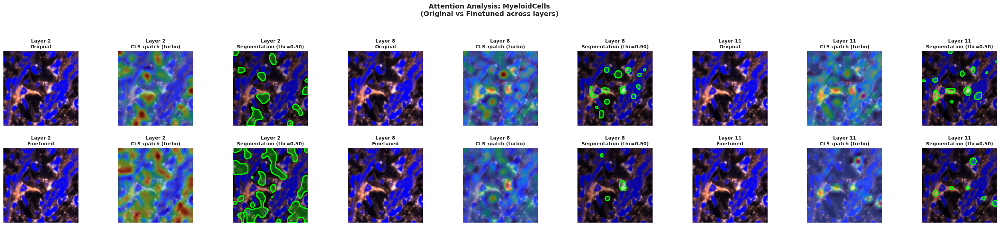

Analysis complete for: MyeloidCells

Sample 2/25

Analyzing: CTL_CD8+KI67+
Image loaded

Saved: attention_CTL_CD8plusKI67plus.png


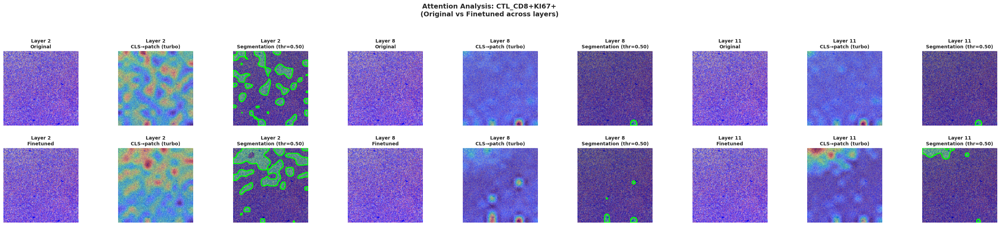

Analysis complete for: CTL_CD8+KI67+

Sample 3/25

Analyzing: CD163_Macrophages
Image loaded

Saved: attention_CD163_Macrophages.png


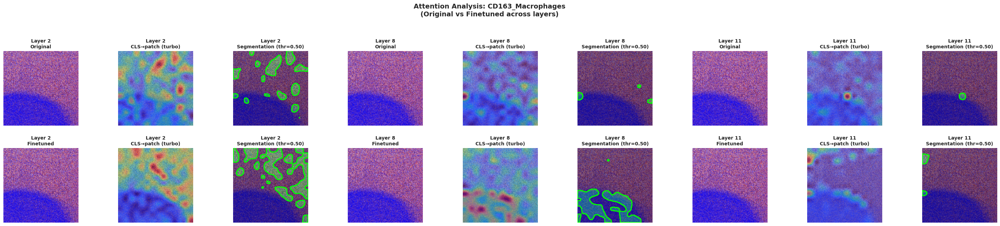

Analysis complete for: CD163_Macrophages

Sample 4/25

Analyzing: Th_CD4+_PD1
Image loaded

Saved: attention_Th_CD4plus_PD1.png


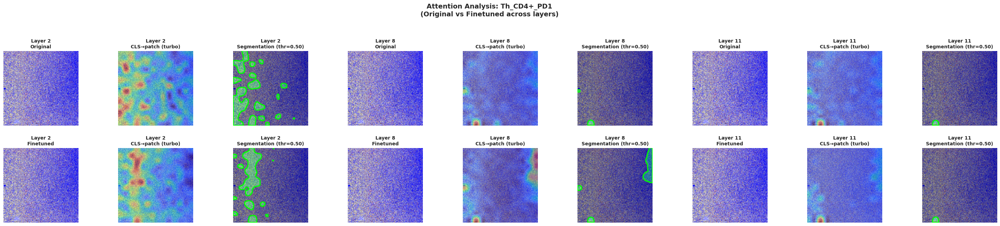

Analysis complete for: Th_CD4+_PD1

Sample 5/25

Analyzing: Th_CD4+
Image loaded

Saved: attention_Th_CD4plus.png


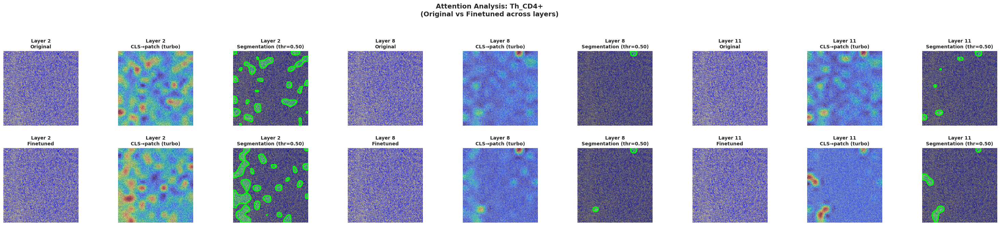

Analysis complete for: Th_CD4+

Sample 6/25

Analyzing: CD163_Macrophages
Image loaded

Saved: attention_CD163_Macrophages.png


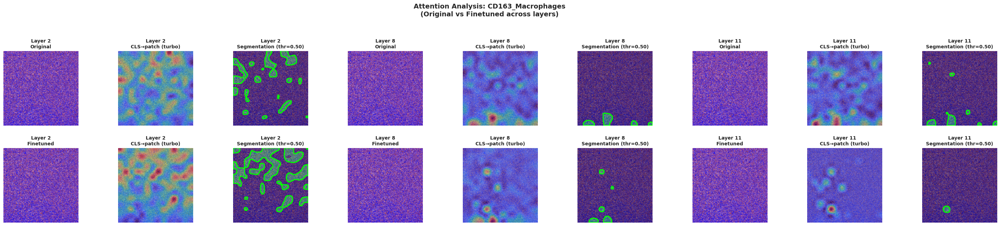

Analysis complete for: CD163_Macrophages

Sample 7/25

Analyzing: Th_CD4+_PD1
Image loaded

Saved: attention_Th_CD4plus_PD1.png


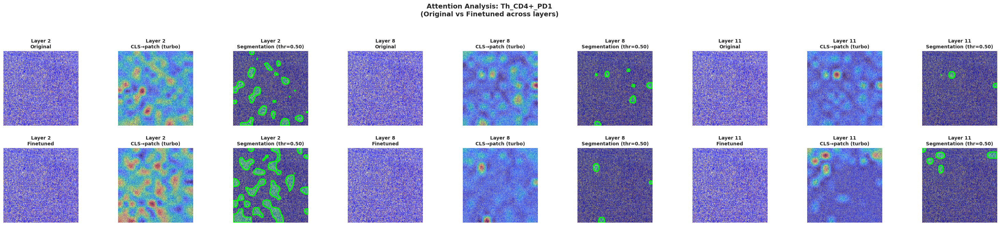

Analysis complete for: Th_CD4+_PD1

Sample 8/25

Analyzing: Bcell
Image loaded

Saved: attention_Bcell.png


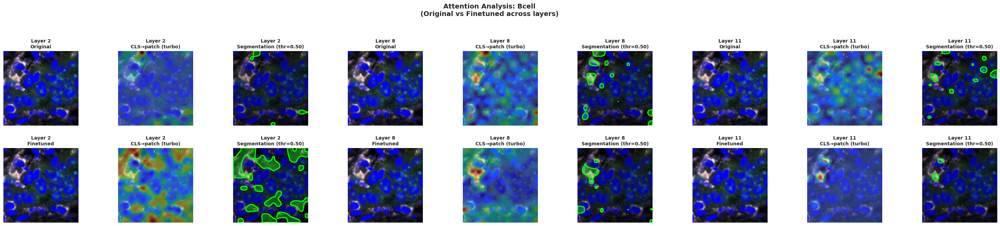

Analysis complete for: Bcell

Sample 9/25

Analyzing: FAP+Fibroblasts
Image loaded

Saved: attention_FAPplusFibroblasts.png


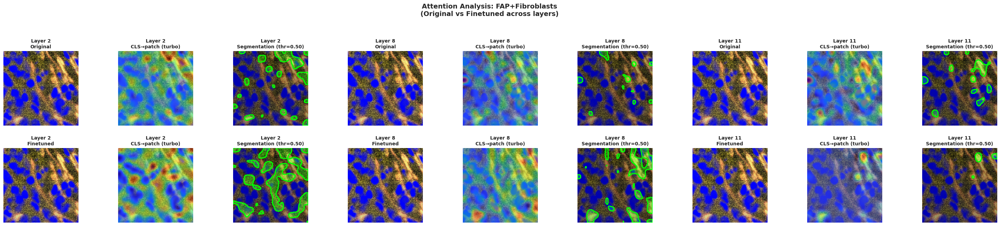

Analysis complete for: FAP+Fibroblasts

Sample 10/25

Analyzing: FAP+Fibroblasts
Image loaded

Saved: attention_FAPplusFibroblasts.png


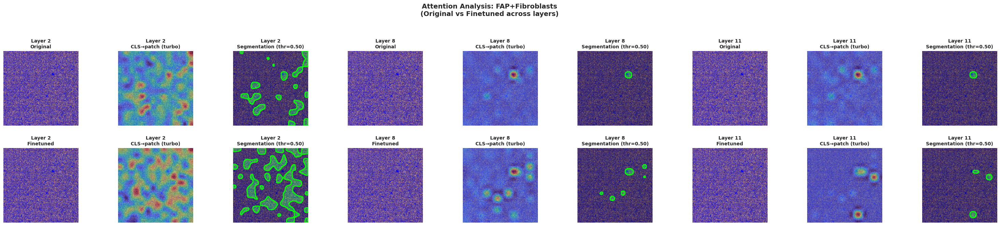

Analysis complete for: FAP+Fibroblasts

Sample 11/25

Analyzing: EndothelialCells
Image loaded

Saved: attention_EndothelialCells.png


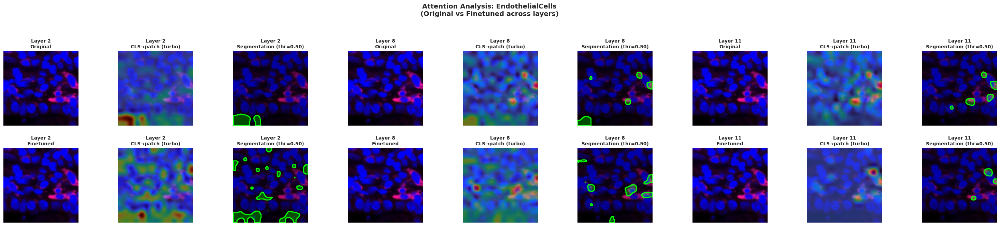

Analysis complete for: EndothelialCells

Sample 12/25

Analyzing: CTL_CD8+KI67+
Image loaded

Saved: attention_CTL_CD8plusKI67plus.png


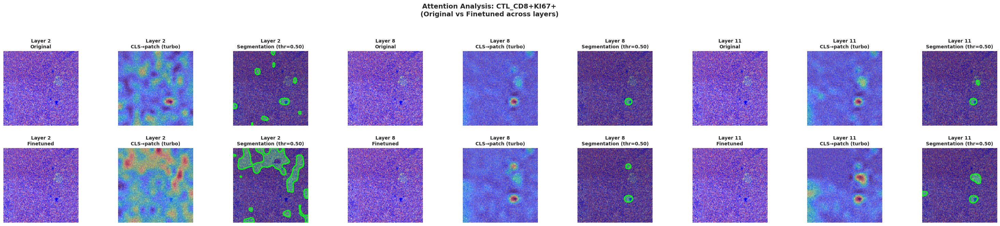

Analysis complete for: CTL_CD8+KI67+

Sample 13/25

Analyzing: Bcell
Image loaded

Saved: attention_Bcell.png


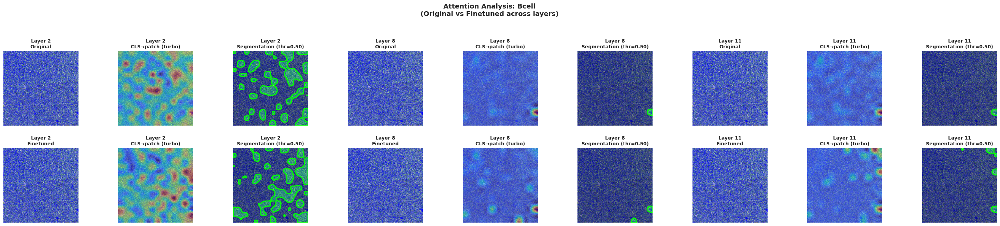

Analysis complete for: Bcell

Sample 14/25

Analyzing: CTL_CD8+KI67+
Image loaded

Saved: attention_CTL_CD8plusKI67plus.png


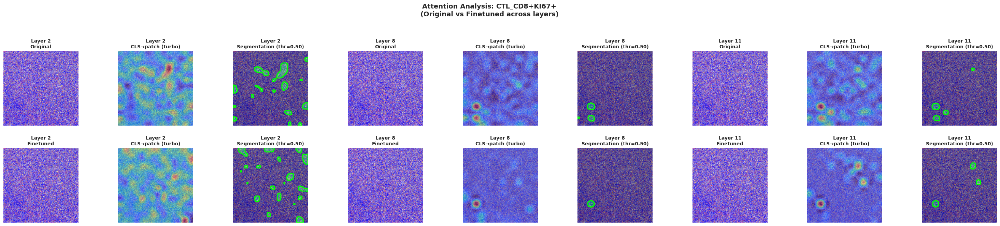

Analysis complete for: CTL_CD8+KI67+

Sample 15/25

Analyzing: CD163_Macrophages
Image loaded

Saved: attention_CD163_Macrophages.png


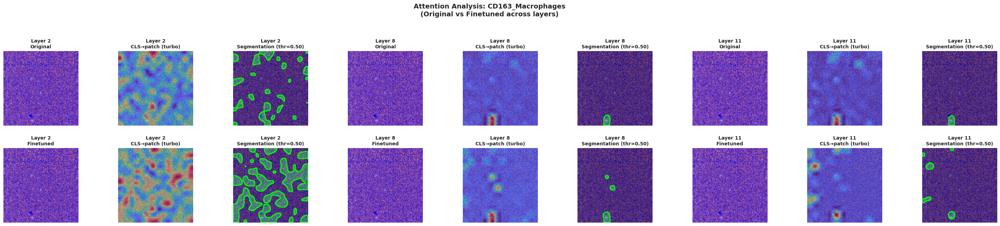

Analysis complete for: CD163_Macrophages

Sample 16/25

Analyzing: CTL_CD8+
Image loaded

Saved: attention_CTL_CD8plus.png


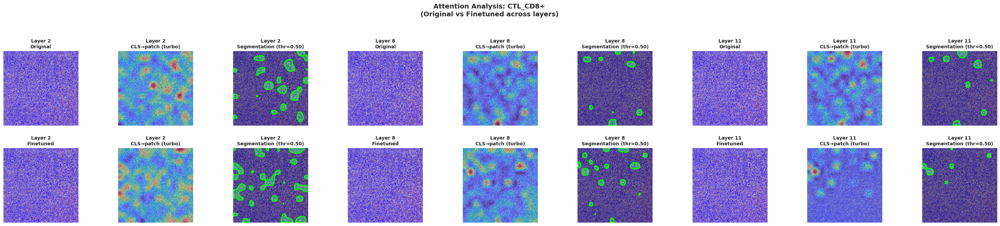

Analysis complete for: CTL_CD8+

Sample 17/25

Analyzing: CD163_Macrophages
Image loaded

Saved: attention_CD163_Macrophages.png


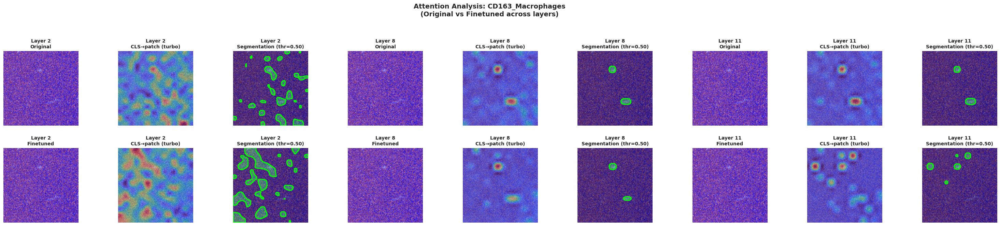

Analysis complete for: CD163_Macrophages

Sample 18/25

Analyzing: MyeloidCells
Image loaded

Saved: attention_MyeloidCells.png


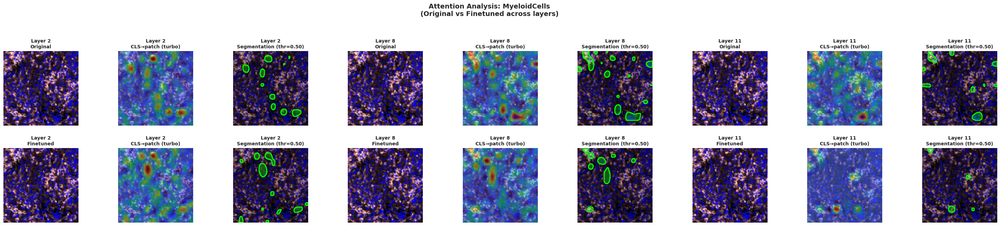

Analysis complete for: MyeloidCells

Sample 19/25

Analyzing: MacrophageCells
Image loaded

Saved: attention_MacrophageCells.png


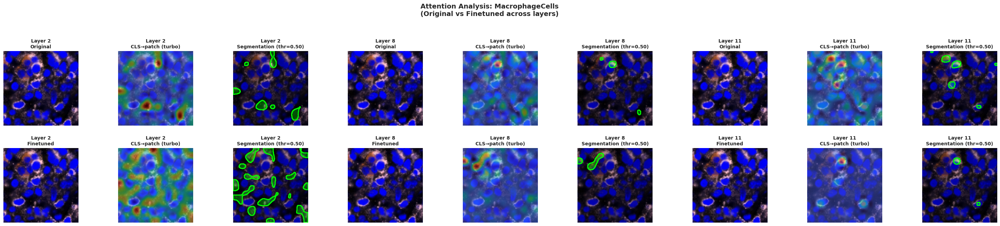

Analysis complete for: MacrophageCells

Sample 20/25

Analyzing: Discoverable
Image loaded

Saved: attention_Discoverable.png


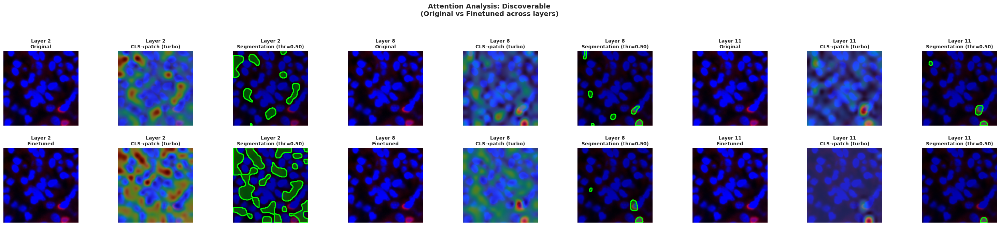

Analysis complete for: Discoverable

Sample 21/25

Analyzing: Bcell
Image loaded

Saved: attention_Bcell.png


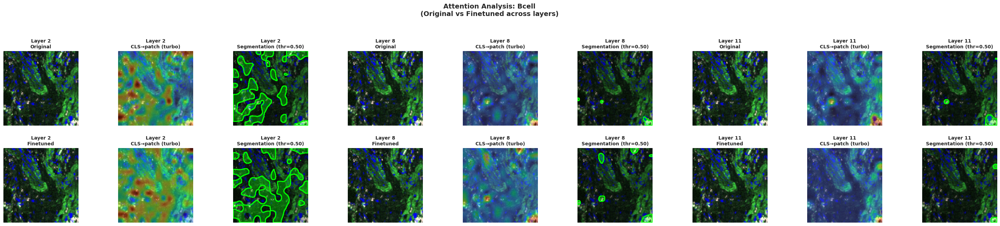

Analysis complete for: Bcell

Sample 22/25

Analyzing: CTL_CD8+KI67+
Image loaded

Saved: attention_CTL_CD8plusKI67plus.png


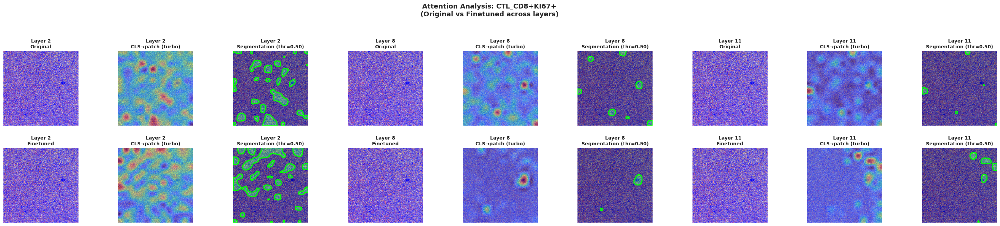

Analysis complete for: CTL_CD8+KI67+

Sample 23/25

Analyzing: Bcell
Image loaded

Saved: attention_Bcell.png


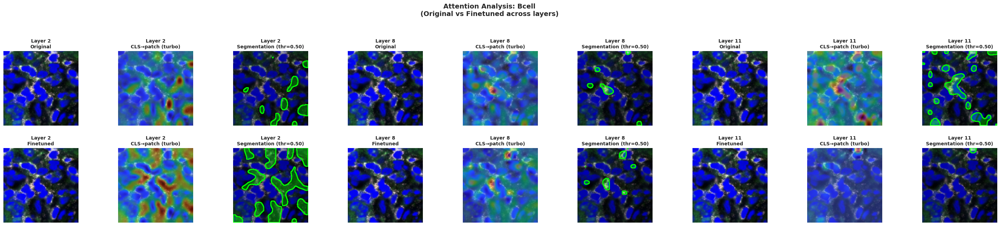

Analysis complete for: Bcell

Sample 24/25

Analyzing: MyeloidCells
Image loaded

Saved: attention_MyeloidCells.png


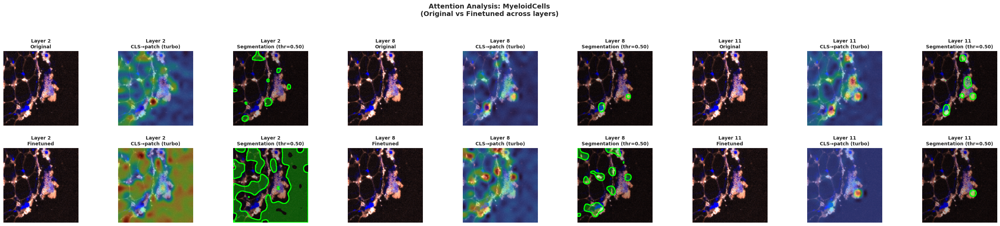

Analysis complete for: MyeloidCells

Sample 25/25

Analyzing: FibroblastCells
Image loaded

Saved: attention_FibroblastCells.png


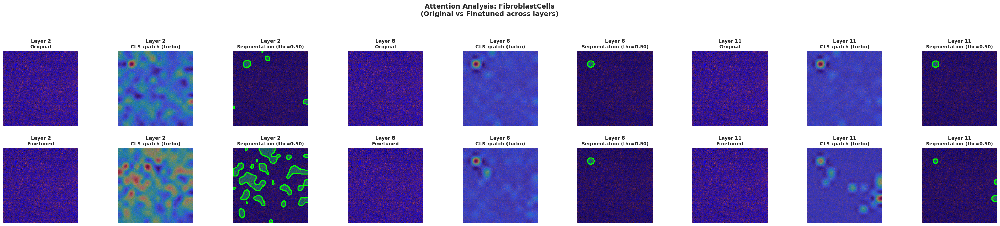

Analysis complete for: FibroblastCells


In [10]:
# Select examples
example_indices = np.random.choice(len(df), min(Config.NUM_EXAMPLES, len(df)), replace=False)
example_df = df.iloc[example_indices].reset_index(drop=True)

print(f"Selected {len(example_df)} examples:")
for idx, row in example_df.iterrows():
    print(f"  [{idx+1}] {row['label']}: {Path(row[Config.CSV_IMAGE_COL]).name}")

print("Starting attention analysis...")

# Resolve base path
if Config.CSV_BASE_PATH:
    base_path = Config.CSV_BASE_PATH
else:
    base_path = Path(Config.CSV_PATH).parent

# Process each example
for idx, row in example_df.iterrows():
    img_path = row[Config.CSV_IMAGE_COL]
    label = row['label']
    
    print(f"\n{'='*80}")
    print(f"Sample {idx+1}/{len(example_df)}")
    print(f"{'='*80}")
    
    try:
        create_comprehensive_visualization(
            img_path, label, extractors,
            Config.LAYERS_TO_VISUALIZE, base_path
        )
    except Exception as e:
        print(f"Error processing {label}: {type(e).__name__}: {e}")
        import traceback
        traceback.print_exc()
        continue

# print(f"\n{'='*80}")
# print("Analysis complete")
# print(f"{'='*80}")
# print(f"Output directory: {OUTPUT_DIR}")
# print(f"Main visualizations: {len(list(OUTPUT_DIR.glob('attention_*.png')))}")
# print(f"Statistics: {len(list((OUTPUT_DIR / 'statistics').glob('*.png')))}")
# print(f"Attention matrices: {len(list((OUTPUT_DIR / 'matrices').glob('*.png')))}")

## Notes

The notebook visualizes attention patterns from DINOv3 Vision Transformer models:

- **Original image**: Shows the input image
- **Attention overlay**: Highlights areas the model attends to
- **Segmentation**: Extracts high-attention regions with contours

Configure the analysis by modifying parameters in the Configuration section above.